Inspired in: https://playground.tensorflow.org/

In [1]:
using Pkg
Pkg.activate("..")

  Activating environment at `E:\Projects\OCDNN.jl\Project.toml`


In [2]:
using Revise
using OCDNN, Printf, Random, Serialization, Plots

In [3]:
gr()

Plots.GRBackend()

In [4]:
function in_dir(f, path::String)
    current = pwd()
    cd(path)
    f()
    cd(current)
end

in_dir (generic function with 1 method)

In [128]:
θ = 0:0.05:4π
n = length(θ)
r = sqrt.(θ);
x = r.*sin.(θ)
y = r.*cos.(θ);
data = [x y; -x -y]
feat = vcat([ones(n),zeros(n)]...);

In [129]:
dataset = data, feat;

In [130]:
N,d = size(data);

In [131]:
idxs = feat .== 1;

In [132]:
Cs = get_color_palette(:tab10, plot_color(:white));

In [133]:
xs = collect(0:0.01:1)
ys = collect(0:0.01:1);

┌ Warning: Skipped marker arg ..
└ @ Plots C:\Users\rafab\.julia\packages\Plots\1RWWg\src\args.jl:1225
┌ Warning: Skipped marker arg ..
└ @ Plots C:\Users\rafab\.julia\packages\Plots\1RWWg\src\args.jl:1225


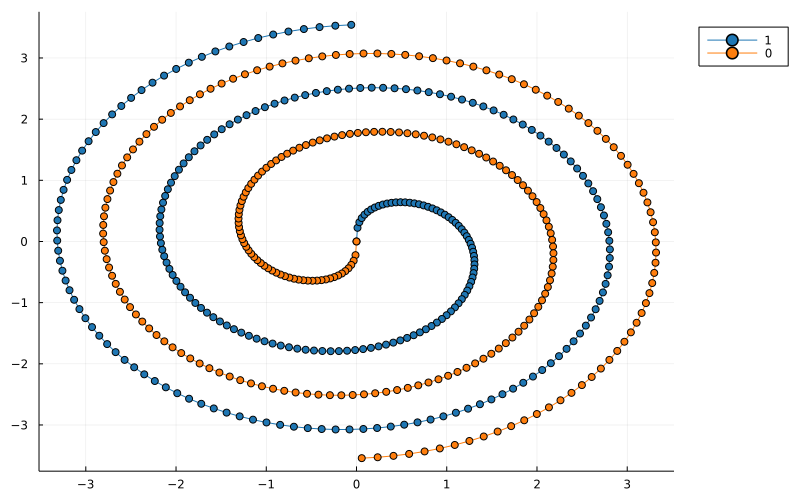

In [134]:
p = Plots.plot(size= (800,500), legend = :outertopright)
Plots.plot!(p,data[:,1][idxs],data[:,2][idxs], m =".", label = 1, c = Cs[1])
Plots.plot!(p,data[:,1][.!idxs],data[:,2][.!idxs], m =".", label = 0, c = Cs[2])

In [171]:
nlayers = 6
channels = 3 # number of neurons per layer
niter = 10_000
τ=0.1;
τ_max=10;
hs = [1, 0.5, 0.1, 0.05];
stepsize = 1

1

In [172]:
A_eu = reshape([0],(1,1));
w_eu = [1];
A_ie = [0 0; 1 0];
w_ie = [0.5 ;0.5];
A_kutta4 = [0 0 0 0;0.5 0 0 0;0 0.5 0 0;0 0 1 0];
w_kutta4 = 1/6*[1;2;2;1];
A_kutta3 = [0 0 0;1/2 0 0;-1 2 0];
w_kutta3 = [1/6;2/3;1/6];

In [173]:
rk4 = ExplicitRungeKutta(A_kutta4,w_kutta4,"RK4");
rk3 = ExplicitRungeKutta(A_kutta3,w_kutta3,"RK3");
rk2 = ExplicitRungeKutta(A_ie,w_ie,"RK2");
euler = ExplicitRungeKutta(A_eu,w_eu,"Euler");
rks = [euler,rk2,rk3,rk4];

In [174]:
names = [rk.name for rk in rks];

In [175]:
eta = x -> exp(x)/(exp(x)+1)

#125 (generic function with 1 method)

In [176]:
problem = Problem(tanh, eta, feat);

In [177]:
function cb(iter, rkmethod, nlayers, α, log, Ctrls)
    period = 2_000
    if rem(iter,period) == 0 || iter == 1
        @printf("\nMethod=%s, nlayers=%d, channels=%d\n",rkmethod.name,nlayers,Ctrls.channels)
        @printf("Iteration no: %d\n",iter)
        @printf("Value of alpha: %7.4f\n",α);
        @printf("Residual: %8.4f\n",log.loss[end])
        @printf("Norm Grad: %8.4e\n",log.grad_norm[end]);
        @printf("Accuracy: %8.4f %% \n",log.accuracy[end]*100);
        if iter > 1
            @printf("Time: %8.4f\n",sum(log.time[end-period+1:end]));
        end
    end
end

cb (generic function with 1 method)

In [178]:
all_results = [train_ode_dnn(dataset, nlayers, channels, rk, niter, τ, τ_max, stepsize, problem, cb) for rk in rks];


Method=Euler, nlayers=6, channels=3
Iteration no: 1
Value of alpha:  0.0016
Residual:  83.0181
Norm Grad: 7.6225e+01
Accuracy:  60.1190 % 

Method=Euler, nlayers=6, channels=3
Iteration no: 2000
Value of alpha:  0.0004
Residual:  27.1822
Norm Grad: 6.0218e+00
Accuracy:  88.0952 % 
Time:   5.5654

Method=Euler, nlayers=6, channels=3
Iteration no: 4000
Value of alpha:  0.0002
Residual:  14.1273
Norm Grad: 3.9346e+00
Accuracy:  94.8413 % 
Time:   4.6302

Method=Euler, nlayers=6, channels=3
Iteration no: 6000
Value of alpha:  0.0008
Residual:  11.3279
Norm Grad: 2.0002e+00
Accuracy:  96.6270 % 
Time:   4.1954

Method=Euler, nlayers=6, channels=3
Iteration no: 8000
Value of alpha:  0.0002
Residual:   9.5374
Norm Grad: 1.6360e+00
Accuracy:  97.2222 % 
Time:   4.5435

Method=Euler, nlayers=6, channels=3
Iteration no: 10000
Value of alpha:  0.0002
Residual:   8.6148
Norm Grad: 1.6082e+00
Accuracy:  97.2222 % 
Time:   4.3331

Method=RK2, nlayers=6, channels=3
Iteration no: 1
Value of alpha:  0

In [179]:
cd("E:\\Projects\\OCDNN.jl\\notebooks")

In [180]:
final_string = string(nlayers)*"_layers_"*string(N)*"_points_"*string(channels)*"_channels_"*string(niter)*"_iter"
traineddir = "..\\train\\Classification_Spiral\\"*final_string*".tmp"
serialize(traineddir, all_results)

In [181]:
final_string = string(nlayers)*"_layers_"*string(N)*"_points_"*string(channels)*"_channels_"*string(niter)*"_iter"
outputdir = "..\\images\\Classification_Spiral\\"*final_string
if !isdir(outputdir)
    mkdir(outputdir)
end

"..\\images\\Classification_Spiral\\6_layers_504_points_3_channels_10000_iter"

In [182]:
all_Ctrls,all_logs = first.(all_results),last.(all_results);

In [183]:
names = ["Euler" "RK2" "RK3" "RK4"]

1×4 Matrix{String}:
 "Euler"  "RK2"  "RK3"  "RK4"

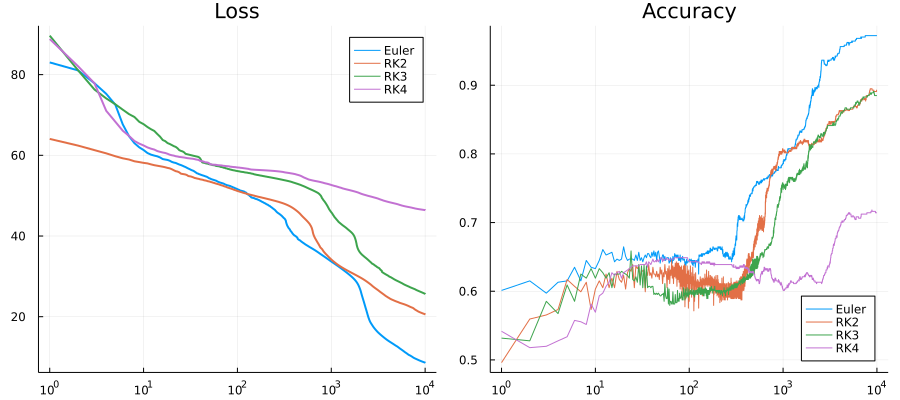

In [184]:
p1 = Plots.plot([all_logs[i].loss for i in 1:4], xaxis = :log10, label = names, linewidth=2)
p2 = Plots.plot([all_logs[i].accuracy for i in 1:4], xaxis = :log10, label = names, legend= :bottomright)
Plots.plot(p1,p2, title = ["Loss" "Accuracy"], size = (900,400))

In [185]:
in_dir(outputdir) do
    Plots.savefig("loss_acc_rks_"*final_string*".pdf")
end

In [186]:
all_times = [sum(all_logs[i].time) for i in 1:4];

In [187]:
CS = get_color_palette(:auto, plot_color(:white))
all_cs = [CS[i] for i in 1:4];

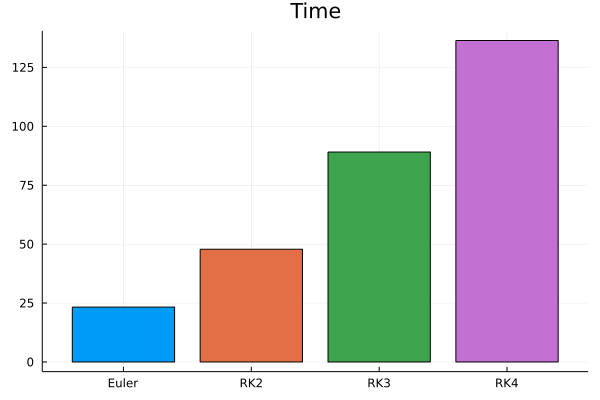

In [188]:
Plots.bar(all_times, xticks = (1:4,names), title = "Time", legend = :none, fillcolor = all_cs)

In [189]:
in_dir(outputdir) do
    Plots.savefig("time_rks_"*final_string*".pdf")
end

In [190]:
all_Ctrls_test = deepcopy.(all_Ctrls);

In [191]:
xs = collect(-4:0.01:4)
ys = collect(-4:0.01:4);

In [192]:
Y0_test = [[x,y] for x in xs, y in ys];

In [193]:
for i in 1:4
    all_Ctrls_test[i].Y0 = hcat(Y0_test...)';
end

In [194]:
classifiers = [[] for i in 1:4]
for i in 1:4
    classifiers[i] = OCDNN.RKforwardstepper(all_Ctrls_test[i],rks[i],problem).Classifier;
end

In [195]:
value = [reshape(round.(classifiers[i]), size(Y0_test))' for i in 1:4];

In [196]:
Cs1 = get_color_palette(:tab10, plot_color(:white));

In [197]:
p = []
for i in 1:4
    pi = Plots.plot(title = names[i], legend = :none, axis = false, ticks = false)
    Plots.contour!(pi,xs,ys, value[i], fill = true, c = [Cs1[2],Cs1[1]])
    Plots.scatter!(pi,data[:,1][idxs],data[:,2][idxs],  c = Cs1[1])
    Plots.scatter!(pi,data[:,1][.!idxs],data[:,2][.!idxs], c = Cs1[2])
    push!(p,pi)
end
Plots.plot(p..., size=(900,600))

In [198]:
in_dir(outputdir) do
    Plots.savefig("contour_plots_rks_"*final_string*".pdf")
end